## importing libraries

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn import metrics

%matplotlib inline

## Load the data

In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/tanlitung/Datasets/master/kc_house_data.csv')
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


## Exploratory Data Analysis

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

### Data Understanding

**Features**
---
- **id**: ID of the house
- **date**: Date of the house sold
- **bedrooms**: Number of bedrooms
- **bathrooms**: Number of bathrooms
- **sqft_living**: Square footage of the house
- **sqft_lot**: Square footage of the lot
- **floors**: Number of floors
- **Waterfront**: 1 - present, 0 - absent
- **view**: 1 - has been viewed, 0 - has not been viewed
- **condition**: 1 - worn out, 5 - excellent
- **grade**: grading for the housing unit, 1 - 13
- **sqft_above**: Square footage of house apart from basement
- **sqrt_below**: Square footage of the basement
- **yr_built**: Year the house was built
- **yr_renovated**: Year the house was renovated
- **zipcode**: Zip code
- **lat**: Latitude coord0nation
- **long**: Longitude coordination
- **sqft_living15**: Square footage of house in 2015 (implies some renovations)
- **sqft_lot**: Square footage of the lot in 2015 (implies some renovations)

**Target**
--- 
- **price**: Price of the house sold


In [4]:
import pyforest
from pandas_profiling import ProfileReport

profile = ProfileReport(df, title='KC house price', explorative=True)
profile.to_notebook_iframe()

/tmp/ipykernel_63729/44469448.py:2: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Dropping irrelevant variables

In [5]:
df.drop(['id', 'date'], axis = 1, inplace = True)

### Data Normalization

Normalization is the process of scaling the data to the range of 0 and 1.

Using MinMaxScaler()

In [6]:
from sklearn import preprocessing

min_max_scaler = preprocessing.MinMaxScaler()
col_name = df.drop('price', axis=1).columns[:]
print(col_name)
x = df.loc[:, col_name]
y = df['price']

# normalizing x
x = pd.DataFrame(data=min_max_scaler.fit_transform(x), columns=col_name)

# Examine the normalized data
print(df.head())
x.head()

Index(['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15'],
      dtype='object')
      price  bedrooms  bathrooms  sqft_living  sqft_lot  floors  waterfront  \
0  221900.0         3       1.00         1180      5650     1.0           0   
1  538000.0         3       2.25         2570      7242     2.0           0   
2  180000.0         2       1.00          770     10000     1.0           0   
3  604000.0         4       3.00         1960      5000     1.0           0   
4  510000.0         3       2.00         1680      8080     1.0           0   

   view  condition  grade  sqft_above  sqft_basement  yr_built  yr_renovated  \
0     0          3      7        1180              0      1955             0   
1     0          3      7        2170            400      1951          1991   
2     0     

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,0.090909,0.12500,0.067170,0.003108,0.0,0.0,0.0,0.5,0.500000,0.097588,0.000000,0.478261,0.000000,0.893939,0.571498,0.217608,0.161934,0.005742
1,0.090909,0.28125,0.172075,0.004072,0.4,0.0,0.0,0.5,0.500000,0.206140,0.082988,0.443478,0.988089,0.626263,0.908959,0.166113,0.222165,0.008027
2,0.060606,0.12500,0.036226,0.005743,0.0,0.0,0.0,0.5,0.416667,0.052632,0.000000,0.286957,0.000000,0.136364,0.936143,0.237542,0.399415,0.008513
3,0.121212,0.37500,0.126038,0.002714,0.0,0.0,0.0,1.0,0.500000,0.083333,0.188797,0.565217,0.000000,0.681818,0.586939,0.104651,0.165376,0.004996
4,0.090909,0.25000,0.104906,0.004579,0.0,0.0,0.0,0.5,0.583333,0.152412,0.000000,0.756522,0.000000,0.368687,0.741354,0.393688,0.241094,0.007871


### Exploratory Data Visualization

Let's examine the relation between feactures and the target variable.

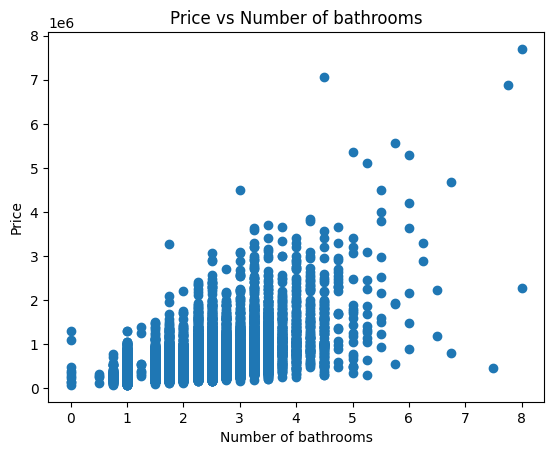

In [7]:
plt.title('Price vs Number of bathrooms')
plt.xlabel('Number of bathrooms')   
plt.ylabel('Price')
plt.scatter(df['bathrooms'], df['price'])
plt.show()

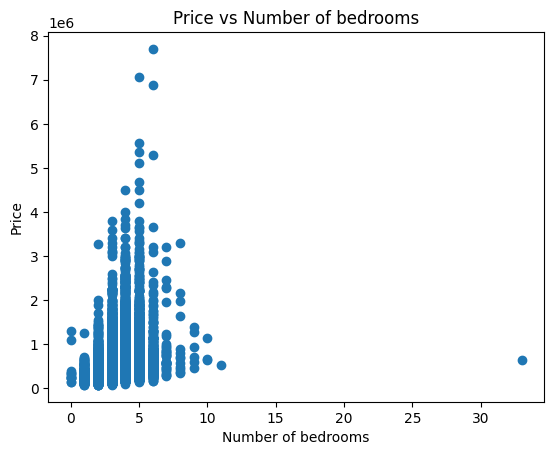

In [8]:
plt.title('Price vs Number of bedrooms')
plt.xlabel('Number of bedrooms')
plt.ylabel('Price')
plt.scatter(df['bedrooms'], df['price'])
plt.show()

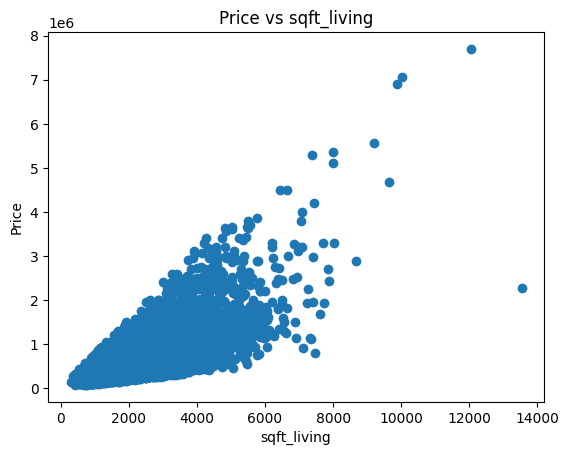

In [9]:
plt.title('Price vs sqft_living')
plt.xlabel('sqft_living')
plt.ylabel('Price')
plt.scatter(df['sqft_living'], df['price'])
plt.show()

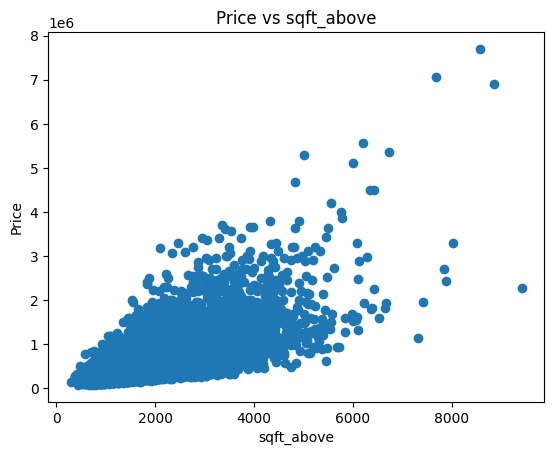

In [10]:
plt.title('Price vs sqft_above')
plt.xlabel('sqft_above')
plt.ylabel('Price')
plt.scatter(df['sqft_above'], df['price'])
plt.show()

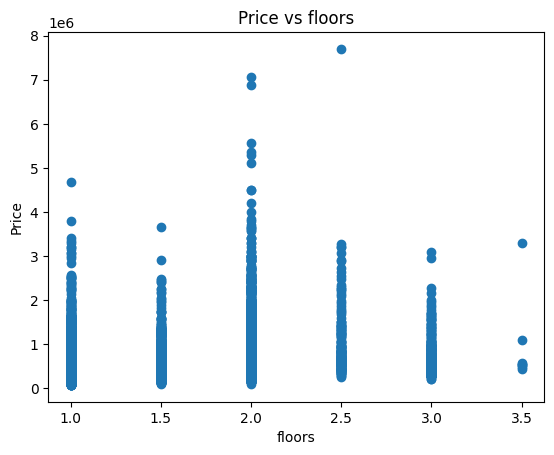

In [11]:
plt.title('Price vs floors')
plt.xlabel('floors')
plt.ylabel('Price')
plt.scatter(df['floors'], df['price'])
plt.show()

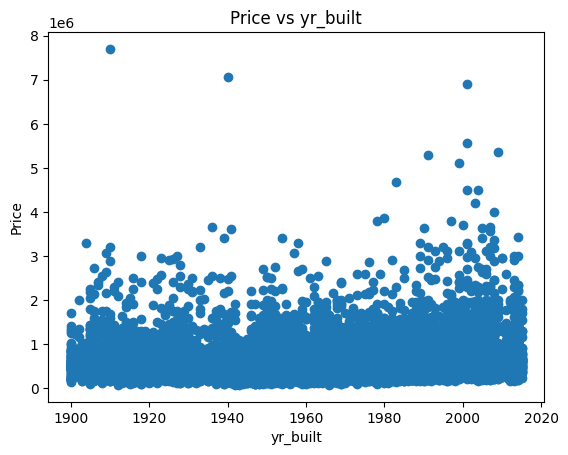

In [12]:
plt.title('Price vs yr_built')
plt.xlabel('yr_built')
plt.ylabel('Price')
plt.scatter(df['yr_built'], df['price'])
plt.show()

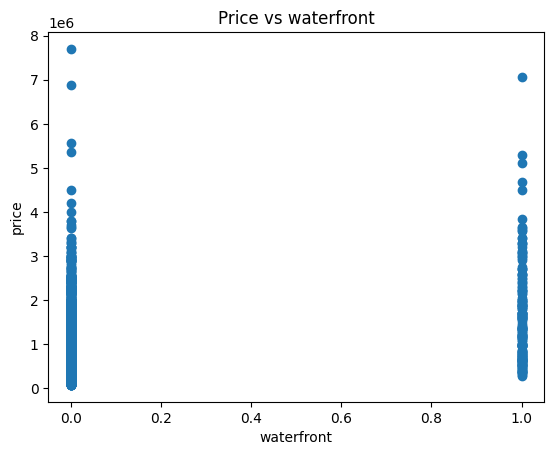

In [13]:
plt.title('Price vs waterfront')
plt.xlabel('waterfront')
plt.ylabel('price')
plt.scatter(df['waterfront'], df['price'])
plt.show()

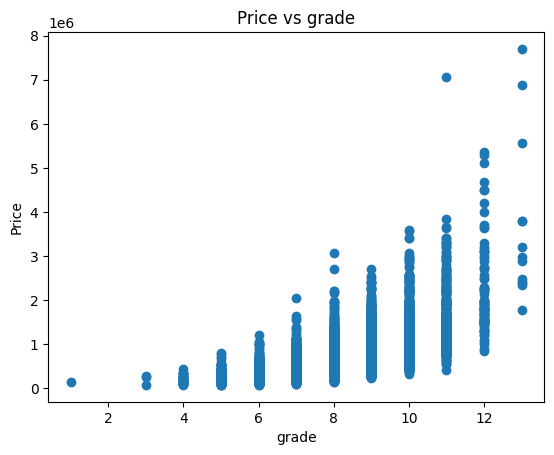

In [14]:
plt.title('Price vs grade')
plt.xlabel('grade')
plt.ylabel('Price')
plt.scatter(df['grade'], df['price'])
plt.show()


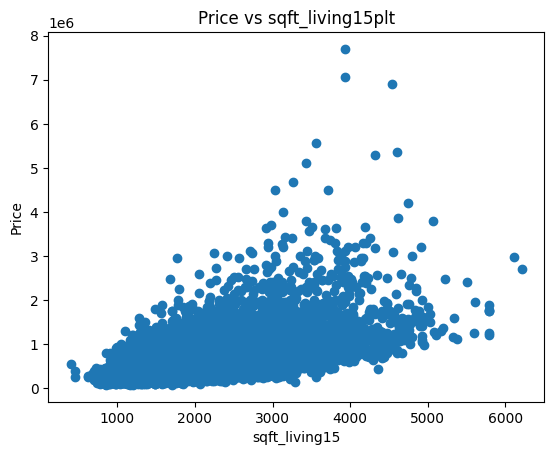

In [15]:
plt.title('Price vs sqft_living15plt')
plt.xlabel('sqft_living15')
plt.ylabel('Price')
plt.scatter(df['sqft_living15'], df['price'])
plt.show()

***Correlation***

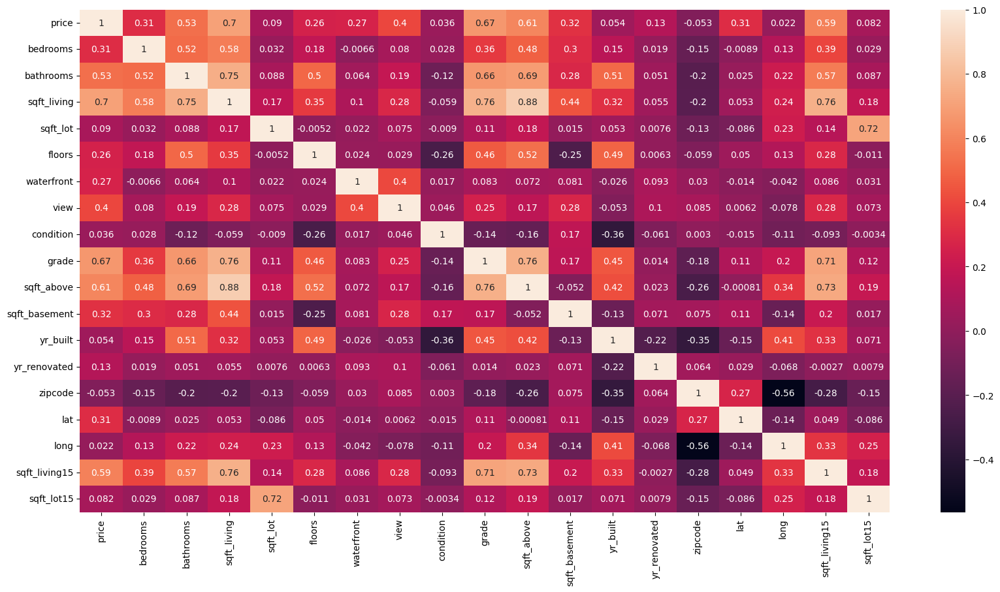

In [16]:
plt.figure(figsize = (20,10))
sns.heatmap(df.corr(), annot=True)
plt.show()

### Splitting the data , Train and Test data

In [17]:
features = df.drop('price', axis = 1)
target = df['price']

X_train, X_test, y_train, y_test = train_test_split(features, target, test_size = 0.25, random_state = 5)

print("X_train shape: ", X_train.shape)
print("X_test shape: ", X_test.shape)
print("y_train shape: ", y_train.shape)
print("y_test shape: ", y_test.shape)

X_train shape:  (16209, 18)
X_test shape:  (5404, 18)
y_train shape:  (16209,)
y_test shape:  (5404,)


### Modeling

In [18]:
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

***Understanding the model***

In [19]:
print("Model intercept: ", model.intercept_, "\n")
print("Coefficients: ", model.coef_, "\n")

for i in range (len(features.columns)):
    print(features.columns[i], ": ", model.coef_[i])

Model intercept:  3756173.7741812235 

Coefficients:  [-3.49379457e+04  3.97750118e+04 -2.59290319e+03  1.42731238e-01
  4.00340674e+03  5.85961914e+05  5.22291382e+04  2.81838396e+04
  9.74405485e+04  2.77462801e+03  2.74172940e+03 -2.62755064e+03
  2.38051981e+01 -5.44544171e+02  6.03368935e+05 -2.08120843e+05
  2.04145849e+01 -3.98567390e-01] 

bedrooms :  -34937.94573033502
bathrooms :  39775.01177485512
sqft_living :  -2592.9031883780913
sqft_lot :  0.14273123811177882
floors :  4003.4067369615964
waterfront :  585961.9140746972
view :  52229.13816823326
condition :  28183.839630867966
grade :  97440.54849985318
sqft_above :  2774.628008444716
sqft_basement :  2741.7294024988405
yr_built :  -2627.550637562162
yr_renovated :  23.8051981183915
zipcode :  -544.54417103947
lat :  603368.9353362881
long :  -208120.84315390236
sqft_living15 :  20.41458486602588
sqft_lot15 :  -0.39856739047536394


### Model Evaluation


In [20]:
train_target_pred = model.predict(X_train)

rmse = (np.sqrt(mean_squared_error(y_train,  train_target_pred)))
r2 = r2_score(y_train, train_target_pred)

# Examine the first 10 predicted output from the model

output = pd.DataFrame(y_train[0:10])
output['Predicted'] = train_target_pred[0:10]
output ['Difference'] = output['Predicted'] - output['price']
print(output, '\n')


print("Model performance for training set")
print("--------------------------------------")
print('RMSE is {}'.format(rmse))
print('R2 score is {}'.format(r2))
print("\n")

#  Model evaluation for testing set
test_target_pred = model.predict(X_test)
rmse = (np.sqrt(mean_squared_error(y_test, test_target_pred)))
r2 = r2_score(y_test, test_target_pred)
output = pd.DataFrame(y_test[:10])
output['Predicted'] = test_target_pred[:10]
output['Difference'] = output['Predicted'] - output['price']
print(output, '\n')

print("Model performance for testing set")
print("--------------------------------------")
print('RMSE is {}'.format(rmse))
print('R2 score is {}'.format(r2))

           price     Predicted     Difference
10180   597000.0  6.096117e+05   12611.725957
4638    652500.0  4.257056e+05 -226794.392595
15437   990000.0  8.516197e+05 -138380.327397
19223   338000.0  1.792568e+05 -158743.176807
16532   407000.0  4.621935e+05   55193.511654
15717   422500.0  3.577647e+05  -64735.268670
13872   500000.0  4.274253e+05  -72574.723622
12903   330000.0  5.819789e+05  251978.890076
17412  1390000.0  1.103305e+06 -286695.389696
7273    555500.0  3.398086e+05 -215691.446630 

Model performance for training set
--------------------------------------
RMSE is 202268.38171069673
R2 score is 0.6983112883210969


          price     Predicted     Difference
17485  365000.0  4.269107e+05   61910.728630
15164  225000.0  9.912855e+04 -125871.445423
18449  384950.0  4.848906e+05   99940.629629
6828   657500.0  5.900679e+05  -67432.091748
18281  959000.0  1.201138e+06  242138.251727
14625  855000.0  8.841348e+05   29134.846889
14864  575000.0  6.405646e+05   65564.62631